# Single Shot Detector with Tensorflow

In [1]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 81917, done.
remote: Counting objects: 100% (383/383), done.
remote: Compressing objects: 100% (170/170), done.
remote: Total 81917 (delta 232), reused 343 (delta 213), pack-reused 81534
Receiving objects: 100% (81917/81917), 596.33 MiB | 16.71 MiB/s, done.
Resolving deltas: 100% (58408/58408), done.


In [2]:
!cd models/research/ && protoc object_detection/protos/*.proto --python_out=.

### Install the object detection API

In [ ]:
!cd models/research/ && cp object_detection/packages/tf2/setup.py . && python -m pip install .

##### Test installation

In [ ]:
!cd models/research/ && python object_detection/builders/model_builder_tf2_test.py 

## Import Libraries

In [22]:
!pip install imageio-ffmpeg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 58.7 MB/s eta 0:00:00


In [6]:
import os
import pathlib
import tensorflow as tf
import imageio

import time 
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils 

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

%matplotlib inline

In [5]:
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

In [7]:
#Dowload video
!wget -nc https://lazyprogrammer.me/cnn_class2_videos.zip
!unzip cnn_class2_videos.zip
!ls

--2023-03-08 01:32:41--  https://lazyprogrammer.me/cnn_class2_videos.zip
Resolving lazyprogrammer.me (lazyprogrammer.me)... 172.67.213.166, 104.21.23.210, 2606:4700:3030::ac43:d5a6, ...
Connecting to lazyprogrammer.me (lazyprogrammer.me)|172.67.213.166|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2073140 (2.0M) [application/zip]
Saving to: ‘cnn_class2_videos.zip’

cnn_class2_videos.z 100%[===================>]   1.98M  3.44MB/s    in 0.6s    

2023-03-08 01:32:42 (3.44 MB/s) - ‘cnn_class2_videos.zip’ saved [2073140/2073140]

Archive:  cnn_class2_videos.zip
  inflating: catdog.mp4              
  inflating: safari.mp4              
  inflating: traffic.mp4             
catdog.mp4  cnn_class2_videos.zip  models  safari.mp4  sample_data  traffic.mp4


In [18]:
import glob

VIDEO_PATHS = [path for path in glob.glob('*.mp4')]
VIDEO_PATHS

['safari.mp4', 'traffic.mp4', 'catdog.mp4']

## Download and extract model files
https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

In [10]:
url = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet101_v1_fpn_640x640_coco17_tpu-8.tar.gz'

PATH_TO_MODEL = tf.keras.utils.get_file(fname='ssd_resnet101_v1_fpn_640x640_coco17_tpu-8',
                                        origin=url,
                                        untar = True)

386527459/386527459 [==============================] - 2s 0us/step


## Download Labels

In [11]:
url = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/data/mscoco_label_map.pbtxt'


PATH_TO_LABELS = tf.keras.utils.get_file(
    fname = 'mscoco_label_map.pbtxt',
    origin = url,
    untar = False
)

5056/5056 [==============================] - 0s 0us/step


In [12]:
!tail {PATH_TO_LABELS}

item {
  name: "/m/03wvsk"
  id: 89
  display_name: "hair drier"
}
item {
  name: "/m/012xff"
  id: 90
  display_name: "toothbrush"
}


## Load the model

In [13]:
PATH_TO_SAVED_MODEL = PATH_TO_MODEL + "/saved_model"

start_time = time.time()
detect__fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()

print("Done! Time: {}".format(end_time - start_time))


Done! Time: 25.44523859024048


## Load labels

In [14]:
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)
category_index

{1: {'id': 1, 'name': 'person'},
 2: {'id': 2, 'name': 'bicycle'},
 3: {'id': 3, 'name': 'car'},
 4: {'id': 4, 'name': 'motorcycle'},
 5: {'id': 5, 'name': 'airplane'},
 6: {'id': 6, 'name': 'bus'},
 7: {'id': 7, 'name': 'train'},
 8: {'id': 8, 'name': 'truck'},
 9: {'id': 9, 'name': 'boat'},
 10: {'id': 10, 'name': 'traffic light'},
 11: {'id': 11, 'name': 'fire hydrant'},
 13: {'id': 13, 'name': 'stop sign'},
 14: {'id': 14, 'name': 'parking meter'},
 15: {'id': 15, 'name': 'bench'},
 16: {'id': 16, 'name': 'bird'},
 17: {'id': 17, 'name': 'cat'},
 18: {'id': 18, 'name': 'dog'},
 19: {'id': 19, 'name': 'horse'},
 20: {'id': 20, 'name': 'sheep'},
 21: {'id': 21, 'name': 'cow'},
 22: {'id': 22, 'name': 'elephant'},
 23: {'id': 23, 'name': 'bear'},
 24: {'id': 24, 'name': 'zebra'},
 25: {'id': 25, 'name': 'giraffe'},
 27: {'id': 27, 'name': 'backpack'},
 28: {'id': 28, 'name': 'umbrella'},
 31: {'id': 31, 'name': 'handbag'},
 32: {'id': 32, 'name': 'tie'},
 33: {'id': 33, 'name': 'suitc

## Do some Object Detection

In [23]:
def detec_objects(img_np):
  input_tensor = tf.convert_to_tensor(img_np)

  #Create tensor as a batch
  input_tensor = input_tensor[tf.newaxis, ...]

  detections = detect__fn(input_tensor)

  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
  detections['num_detections'] = num_detections

  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = img_np.copy()


  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates = True,
      max_boxes_to_draw = 200,
      min_score_thresh = 0.30,
      agnostic_mode = False
    )

  return image_np_with_detections

In [38]:
def detect_object_in_video(input_video):
  frames = []

  video_reader = imageio.get_reader(f'{input_video}')

  t0 = time.time()
  n_frames = 0

  for frame in video_reader:
    n_frames += 1
    new_frame = detec_objects(frame)

    frames.append(new_frame)

  fps = n_frames / (time.time() - t0)
  print("Frames processed: {}, fps: {}".format(n_frames, fps))

  path =  input_video.split('.')[0] + '.gif'

  imageio.mimsave(path, frames)

Frames processed: 100, fps: 2.625225000182294


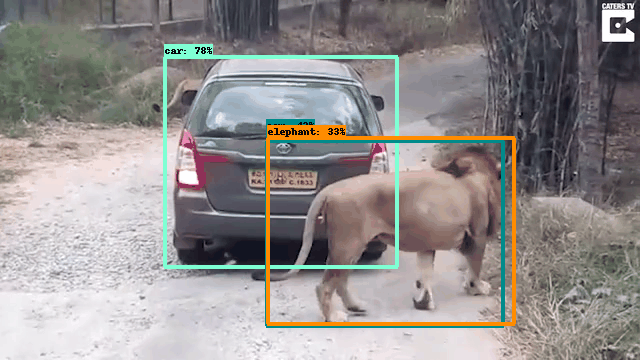

In [45]:
from IPython.display import Image

detect_object_in_video(VIDEO_PATHS[0])
Image(open( VIDEO_PATHS[0].split('.')[0] + '.gif' ,'rb').read())

Frames processed: 70, fps: 2.532136890069766


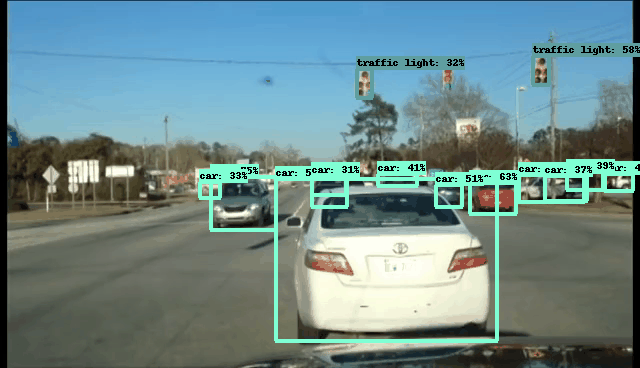

In [46]:
detect_object_in_video(VIDEO_PATHS[1])
Image(open( VIDEO_PATHS[1].split('.')[0] + '.gif' ,'rb').read())

Frames processed: 50, fps: 2.680226787751993


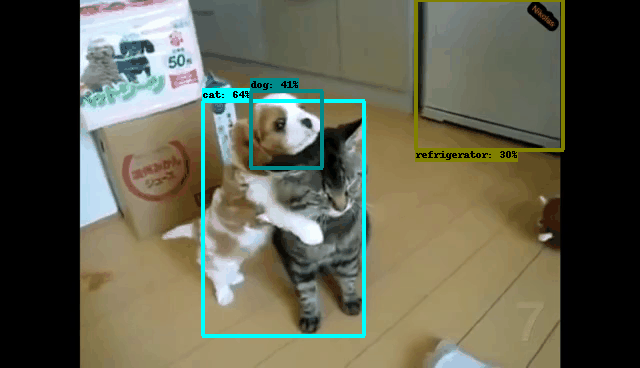

In [47]:
detect_object_in_video(VIDEO_PATHS[2])
Image(open( VIDEO_PATHS[2].split('.')[0] + '.gif' ,'rb').read())